In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam

num_classes = 10

model = Sequential([
    Conv2D(64, (3, 3), activation='relu', padding='same', input_shape=(40, 130, 1)),
    BatchNormalization(),
    MaxPooling2D((2, 2)),
    Dropout(0.3),
    Conv2D(128, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPooling2D((2, 2)),
    Dropout(0.3),
    Conv2D(256, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPooling2D((2, 2)),
    Dropout(0.3),
    Conv2D(512, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPooling2D((2, 2)),
    Dropout(0.4),
    Flatten(),
    Dense(256, activation='relu'),
    Dropout(0.4),
    Dense(num_classes, activation='softmax')
])

model.compile(optimizer=Adam(learning_rate=1e-5), loss='categorical_crossentropy', metrics=['accuracy'])
model.save("/content/cnn_mfcc_model_40.keras", save_format='keras')

In [ ]:
from tensorflow.keras.models import load_model

loaded_model = load_model("/content/cnn_mfcc_model_40.keras")

loaded_model.summary()


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 40, 130, 64)       640       
                                                                 
 batch_normalization (Batch  (None, 40, 130, 64)       256       
 Normalization)                                                  
                                                                 
 max_pooling2d (MaxPooling2  (None, 20, 65, 64)        0         
 D)                                                              
                                                                 
 dropout (Dropout)           (None, 20, 65, 64)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 20, 65, 128)       73856     
                                                                 
 batch_normalization_1 (Bat  (None, 20, 65, 128)       5

In [3]:
!pip install innvestigate

In [4]:
import tensorflow as tf

/usr/local/lib/python3.11/dist-packages/innvestigate/backend/graph.py:467: UserWarning: Ignore dtype <dtype: 'float32'> as bias type.
  warnings.warn(f"Ignore dtype {dtype} as bias type.")
/usr/local/lib/python3.11/dist-packages/innvestigate/backend/graph.py:480: UserWarning: Ignore dtype <dtype: 'float32'> as bias type.
  warnings.warn(f"Ignore dtype {dtype} as bias type.")
/usr/local/lib/python3.11/dist-packages/keras/src/engine/training_v1.py:2359: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates=self.state_updates,


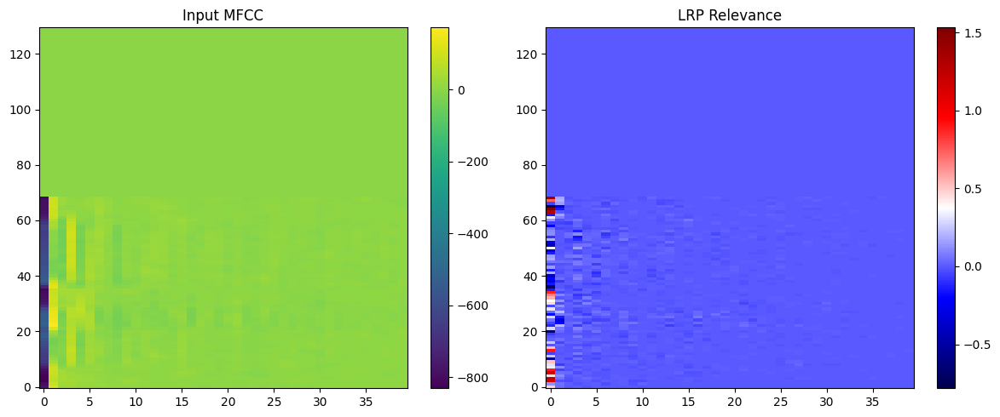

In [ ]:
import tensorflow as tf
tf.compat.v1.disable_eager_execution()

import numpy as np
import matplotlib.pyplot as plt
import innvestigate

model = tf.keras.models.load_model("/content/cnn_mfcc_model_40.keras")

model_wo_sm = tf.keras.Model(inputs=model.input, outputs=model.layers[-1].input)

data = np.load("/content/mfcc_40_dataset.npz")
X = data["X"]
y = data["y"]


if X.ndim == 3:
    X = X[..., np.newaxis] 

sample_idx = 0  # Pick any index
input_sample = X[sample_idx:sample_idx+1]

analyzer = innvestigate.create_analyzer("lrp.z", model_wo_sm)

sess = tf.compat.v1.keras.backend.get_session()
sess.run(tf.compat.v1.global_variables_initializer())

relevance = analyzer.analyze(input_sample)

plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.title("Input MFCC")
plt.imshow(input_sample[0, :, :, 0].T, origin="lower", aspect="auto", cmap="viridis")
plt.colorbar()

plt.subplot(1, 2, 2)
plt.title("LRP Relevance")
plt.imshow(relevance[0, :, :, 0].T, origin="lower", aspect="auto", cmap="seismic")
plt.colorbar()

plt.tight_layout()
plt.show()


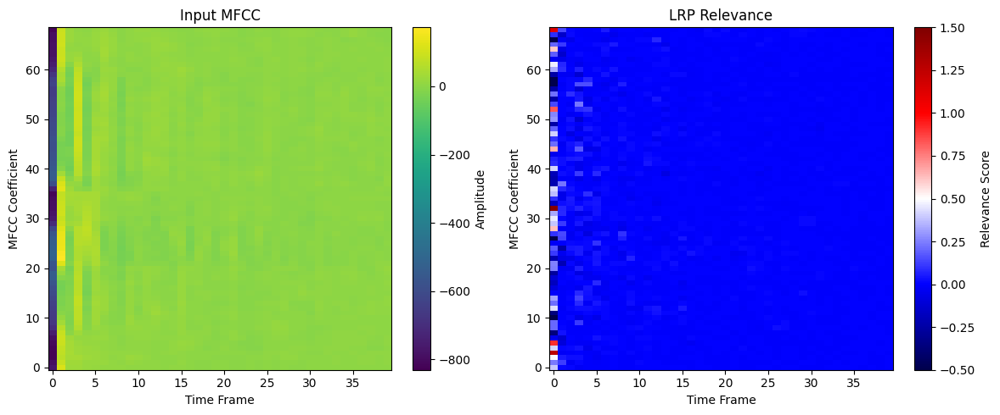

In [ ]:
import tensorflow as tf
tf.compat.v1.disable_eager_execution()

import numpy as np
import matplotlib.pyplot as plt
import innvestigate

model = tf.keras.models.load_model("/content/cnn_mfcc_model_40.keras")

model_wo_sm = tf.keras.Model(inputs=model.input, outputs=model.layers[-1].input)

data = np.load("/content/drive/MyDrive/mfcc_40_dataset.npz")
X = data["X"]
y = data["y"]

if X.ndim == 3:
    X = X[..., np.newaxis] 

sample_idx = 0
input_sample = X[sample_idx:sample_idx+1]

analyzer = innvestigate.create_analyzer("lrp.z", model_wo_sm)

sess = tf.compat.v1.keras.backend.get_session()
sess.run(tf.compat.v1.global_variables_initializer())

relevance = analyzer.analyze(input_sample)

mfcc_data = input_sample[0, :, :, 0] 
energy_per_time = np.sum(np.abs(mfcc_data), axis=0) 

threshold = 1e-5
valid_indices = np.where(energy_per_time > threshold)[0]

if valid_indices.size == 0:
    print("Warning: No significant energy found in the input sample.")
    start_idx, end_idx = 0, mfcc_data.shape[1]
else:
    start_idx, end_idx = valid_indices[0], valid_indices[-1] + 1

mfcc_crop = mfcc_data[:, start_idx:end_idx]
relevance_crop = relevance[0, :, :, 0][:, start_idx:end_idx]

plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.title("Input MFCC")
plt.imshow(mfcc_crop.T, origin="lower", aspect="auto", cmap="viridis")
plt.xlabel("Time Frame")
plt.ylabel("MFCC Coefficient")
plt.colorbar(label="Amplitude")

plt.subplot(1, 2, 2)
plt.title("LRP Relevance")
plt.imshow(relevance_crop.T, origin="lower", aspect="auto", cmap="seismic", vmin=-0.5, vmax=1.5)
plt.xlabel("Time Frame")
plt.ylabel("MFCC Coefficient")
plt.colorbar(label="Relevance Score")

plt.tight_layout()
plt.show()

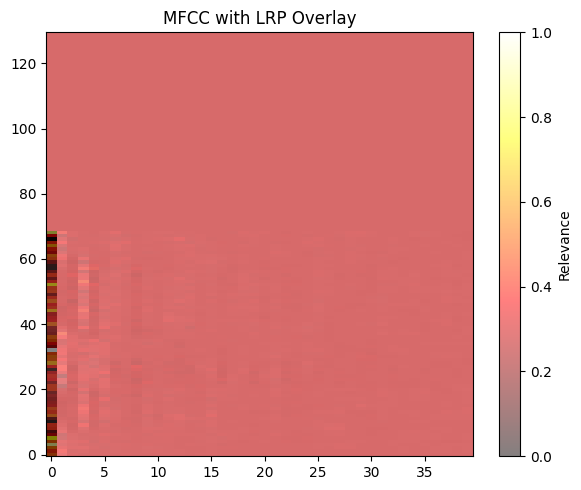

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(6, 5))
plt.title("MFCC with LRP Overlay")

relevance_norm = (relevance[0, :, :, 0] - np.min(relevance)) / (np.max(relevance) - np.min(relevance))

plt.imshow(input_sample[0, :, :, 0].T, origin="lower", aspect="auto", cmap="gray")
plt.imshow(relevance_norm.T, origin="lower", aspect="auto", cmap="hot", alpha=0.5)

plt.colorbar(label="Relevance")
plt.tight_layout()
plt.show()

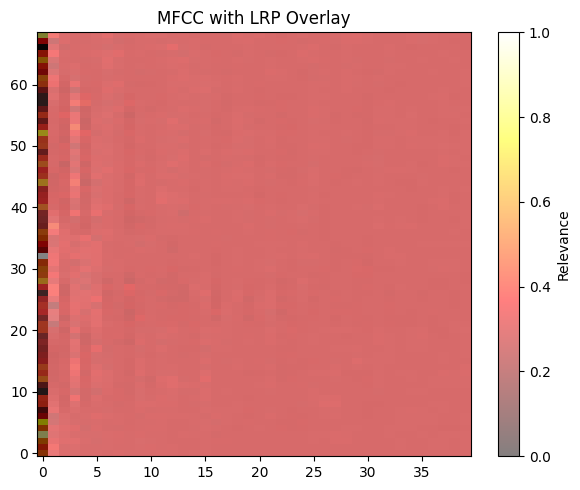

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
mfcc = input_sample[0, :, :, 0]
rel = relevance[0, :, :, 0]

energy = np.sum(np.abs(mfcc), axis=1)
valid_rows = np.where(energy > 1e-5)[0]

energy_col = np.sum(np.abs(mfcc), axis=0)
valid_cols = np.where(energy_col > 1e-5)[0]

mfcc_crop = mfcc[np.min(valid_rows):np.max(valid_rows)+1, np.min(valid_cols):np.max(valid_cols)+1]
rel_crop = rel[np.min(valid_rows):np.max(valid_rows)+1, np.min(valid_cols):np.max(valid_cols)+1]

rel_norm = (rel_crop - np.min(rel_crop)) / (np.max(rel_crop) - np.min(rel_crop) + 1e-10)

plt.figure(figsize=(6, 5))
plt.title("MFCC with LRP Overlay")
plt.imshow(mfcc_crop.T, origin="lower", aspect="auto", cmap="gray")
plt.imshow(rel_norm.T, origin="lower", aspect="auto", cmap="hot", alpha=0.5)
plt.colorbar(label="Relevance")
plt.tight_layout()
plt.show()


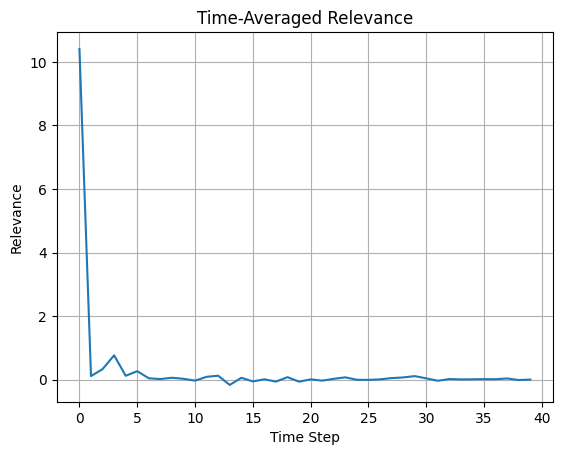

In [ ]:
time_relevance = np.sum(relevance[0, :, :, 0], axis=1)
plt.plot(time_relevance)
plt.title("Time-Averaged Relevance")
plt.xlabel("Time Step")
plt.ylabel("Relevance")
plt.grid(True)
plt.show()


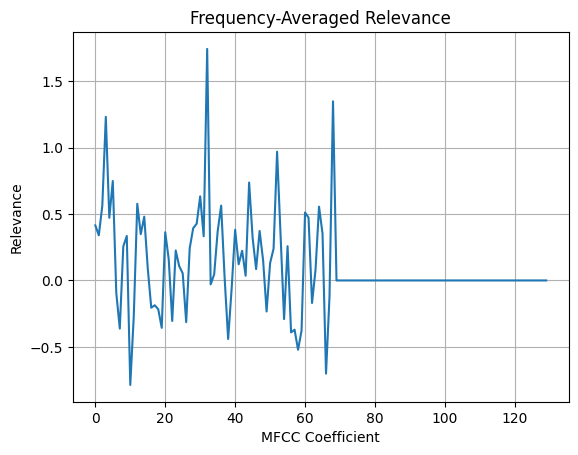

In [ ]:
freq_relevance = np.sum(relevance[0, :, :, 0], axis=0)
plt.plot(freq_relevance)
plt.title("Frequency-Averaged Relevance")
plt.xlabel("MFCC Coefficient")
plt.ylabel("Relevance")
plt.grid(True)
plt.show()


In [12]:
import plotly.express as px
fig = px.imshow(relevance[0, :, :, 0].T, origin='lower', color_continuous_scale='RdBu', title='Interactive LRP Relevance')
fig.show()

# LRP - SPectrogram - Audio Mnist ( Code_kaggle_Research_Mail_3 )

In [1]:
!pip install innvestigate

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 840.9/840.9 kB 11.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 4.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 4.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.3/18.3 MB 55.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 489.9/489.9 MB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 44.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 60.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 294.6/294.6 kB 18.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 90.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 440.7/440.7 kB 26.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.4/78.4 kB 5.1 MB/s eta 0:00:00
  Created wheel for future: filename=future-0.18.3-py3-none-any.whl size=492025 sha256=876

**after installation need to restart session**



In [1]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import innvestigate
import innvestigate.utils as iutils


In [ ]:
data = np.load("/content/drive/MyDrive/audio_mnist_spectrograms.npz")
X = data["X"] 
y = data["y"] 

In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam

num_classes = 10

model = Sequential([
    Input(shape=(257, 128, 1)), 
    Conv2D(64, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPooling2D((2, 2)),
    Dropout(0.3),

    Conv2D(128, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPooling2D((2, 2)),
    Dropout(0.3),

    Conv2D(256, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPooling2D((2, 2)),
    Dropout(0.3),

    Conv2D(512, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPooling2D((2, 2)),
    Dropout(0.4),

    Flatten(),
    Dense(256, activation='relu'),
    Dropout(0.4),
    Dense(num_classes, activation='softmax')
])

model.compile(optimizer=Adam(learning_rate=1e-5), loss='categorical_crossentropy', metrics=['accuracy'])
model.save("/content/cnn_spectrogram_model.keras", save_format='keras')


In [7]:
model = tf.keras.models.load_model("/content/cnn_spectrogram_model.keras")
model.summary()


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 257, 128, 64)      640       
                                                                 
 batch_normalization (Batch  (None, 257, 128, 64)      256       
 Normalization)                                                  
                                                                 
 max_pooling2d (MaxPooling2  (None, 128, 64, 64)       0         
 D)                                                              
                                                                 
 dropout (Dropout)           (None, 128, 64, 64)       0         
                                                                 
 conv2d_1 (Conv2D)           (None, 128, 64, 128)      73856     
                                                                 
 batch_normalization_1 (Bat  (None, 128, 64, 128)      5

/usr/local/lib/python3.11/dist-packages/innvestigate/backend/graph.py:467: UserWarning: Ignore dtype <dtype: 'float32'> as bias type.
  warnings.warn(f"Ignore dtype {dtype} as bias type.")
/usr/local/lib/python3.11/dist-packages/innvestigate/backend/graph.py:480: UserWarning: Ignore dtype <dtype: 'float32'> as bias type.
  warnings.warn(f"Ignore dtype {dtype} as bias type.")
/usr/local/lib/python3.11/dist-packages/keras/src/engine/training_v1.py:2359: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates=self.state_updates,


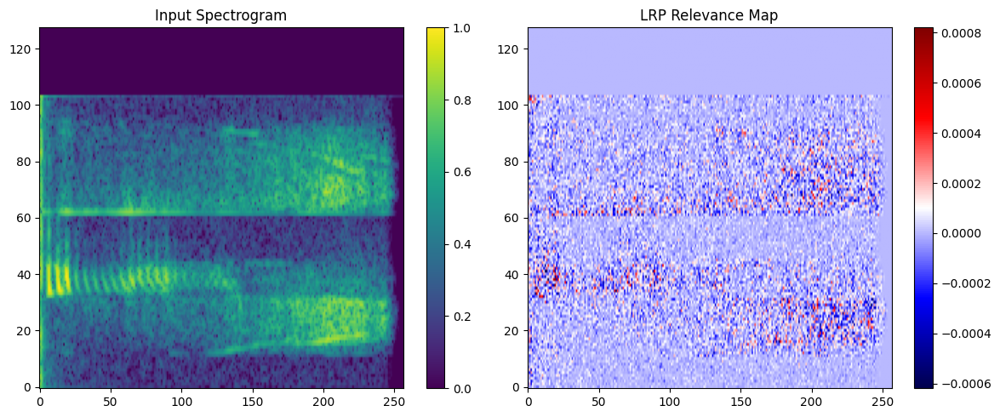

In [ ]:
import tensorflow as tf
tf.compat.v1.disable_eager_execution() 

import numpy as np
import matplotlib.pyplot as plt
import innvestigate

model = tf.keras.models.load_model("/content/cnn_spectrogram_model.keras")

model_wo_sm = tf.keras.Model(inputs=model.input, outputs=model.layers[-1].input)

data = np.load("/content/drive/MyDrive/audio_mnist_spectrograms.npz")
X = data["X"] 
y = data["y"] 

if X.ndim == 3:
    X = X[..., np.newaxis]

sample_idx = 0
input_sample = X[sample_idx:sample_idx + 1]

analyzer = innvestigate.create_analyzer("lrp.z", model_wo_sm)

sess = tf.compat.v1.keras.backend.get_session()
sess.run(tf.compat.v1.global_variables_initializer())

relevance = analyzer.analyze(input_sample)

plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.title("Input Spectrogram")
plt.imshow(input_sample[0, :, :, 0].T, origin="lower", aspect="auto", cmap="viridis")
plt.colorbar()

plt.subplot(1, 2, 2)
plt.title("LRP Relevance Map")
plt.imshow(relevance[0, :, :, 0].T, origin="lower", aspect="auto", cmap="seismic")
plt.colorbar()

plt.tight_layout()
plt.show()


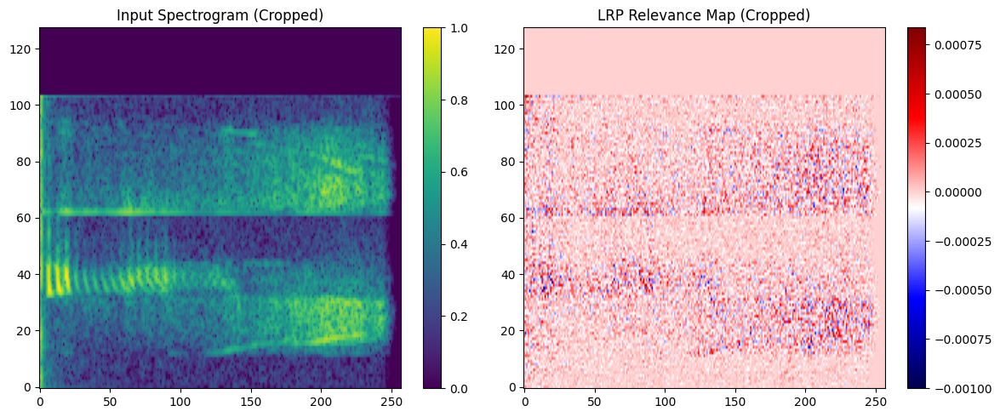

In [ ]:

model = tf.keras.models.load_model("/content/cnn_spectrogram_model.keras")

model_wo_sm = tf.keras.Model(inputs=model.input, outputs=model.layers[-1].input)

data = np.load("/content/drive/MyDrive/audio_mnist_spectrograms.npz")
X = data["X"]  
y = data["y"] 

if X.ndim == 3:
    X = X[..., np.newaxis]  

sample_idx = 0
input_sample = X[sample_idx:sample_idx + 1]

analyzer = innvestigate.create_analyzer("lrp.z", model_wo_sm)
sess = tf.compat.v1.keras.backend.get_session()
sess.run(tf.compat.v1.global_variables_initializer())

relevance = analyzer.analyze(input_sample)

non_zero_rows = np.where(np.max(input_sample[0, :, :, 0], axis=1) > 1e-4)[0]
min_row, max_row = non_zero_rows[0], non_zero_rows[-1] + 1

plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.title("Input Spectrogram (Cropped)")
plt.imshow(input_sample[0, min_row:max_row, :, 0].T, origin="lower", aspect="auto", cmap="viridis")
plt.colorbar()

plt.subplot(1, 2, 2)
plt.title("LRP Relevance Map (Cropped)")
plt.imshow(relevance[0, min_row:max_row, :, 0].T, origin="lower", aspect="auto", cmap="seismic")
plt.colorbar()

plt.tight_layout()
plt.show()


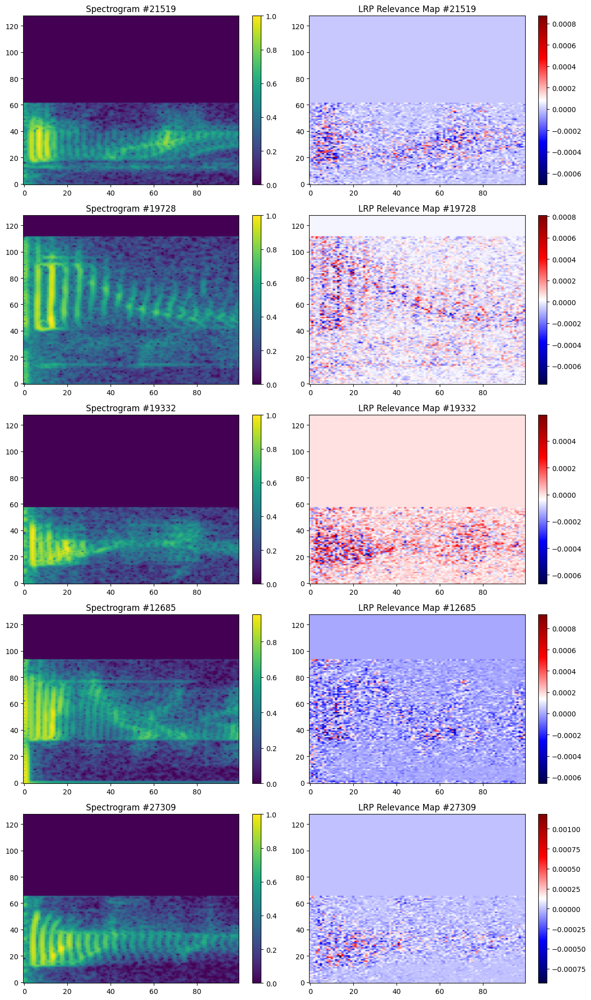

In [ ]:
import random

num_samples_to_plot = 5
indices = random.sample(range(X.shape[0]), num_samples_to_plot)

plt.figure(figsize=(12, 4 * num_samples_to_plot))

for i, idx in enumerate(indices):
    input_sample = X[idx:idx + 1]
    relevance = analyzer.analyze(input_sample)
    freq_crop = slice(0, 100)

    plt.subplot(num_samples_to_plot, 2, 2 * i + 1)
    plt.title(f"Spectrogram #{idx}")
    plt.imshow(input_sample[0, freq_crop, :, 0].T, origin="lower", aspect="auto", cmap="viridis")
    plt.colorbar()

    plt.subplot(num_samples_to_plot, 2, 2 * i + 2)
    plt.title(f"LRP Relevance Map #{idx}")
    plt.imshow(relevance[0, freq_crop, :, 0].T, origin="lower", aspect="auto", cmap="seismic")
    plt.colorbar()

plt.tight_layout()
plt.show()


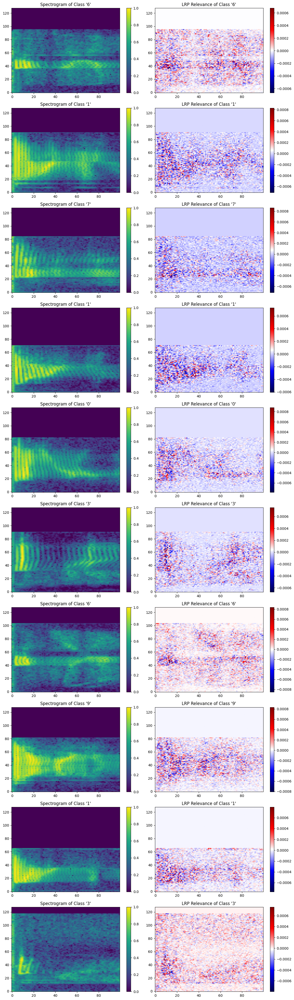

In [ ]:
import random
num_samples_to_plot = 10
indices = random.sample(range(X.shape[0]), num_samples_to_plot)

plt.figure(figsize=(12, 4 * num_samples_to_plot))

for i, idx in enumerate(indices):
    input_sample = X[idx:idx + 1]
    label = y[idx] 

    relevance = analyzer.analyze(input_sample)
    freq_crop = slice(0, 100)

    plt.subplot(num_samples_to_plot, 2, 2 * i + 1)
    plt.title(f"Spectrogram of Class '{label}'")
    plt.imshow(input_sample[0, freq_crop, :, 0].T, origin="lower", aspect="auto", cmap="viridis")
    plt.colorbar()
    plt.subplot(num_samples_to_plot, 2, 2 * i + 2)
    plt.title(f"LRP Relevance of Class '{label}'")
    plt.imshow(relevance[0, freq_crop, :, 0].T, origin="lower", aspect="auto", cmap="seismic")
    plt.colorbar()

plt.tight_layout()
plt.show()


In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def plot_spectrogram_with_lrp(input_sample, relevance, label=None, class_names=None):
    """
    Plot a spectrogram with LRP relevance heatmap overlay.

    Args:
        input_sample: (1, freq, time, 1) input spectrogram
        relevance: (1, freq, time, 1) relevance map
        label: class index (int)
        class_names: list of class names
    """
    spect = input_sample[0, :, :, 0]
    rel = relevance[0, :, :, 0]
    energy = np.sum(np.abs(spect), axis=1)
    valid_rows = np.where(energy > 1e-5)[0]
    fmin, fmax = np.min(valid_rows), np.max(valid_rows)
    spect_crop = spect[fmin:fmax+1, :]
    rel_crop = rel[fmin:fmax+1, :]

    rel_norm = (rel_crop - np.min(rel_crop)) / (np.max(rel_crop) - np.min(rel_crop) + 1e-10)

    plt.figure(figsize=(7, 5))
    title = "Spectrogram with LRP Overlay"
    if label is not None and class_names is not None:
        title += f" | Class: {class_names[label]}"
    elif label is not None:
        title += f" | Class ID: {label}"
    plt.title(title)

    plt.imshow(spect_crop.T, origin="lower", aspect="auto", cmap="gray")
    plt.imshow(rel_norm.T, origin="lower", aspect="auto", cmap="hot", alpha=0.5)
    plt.colorbar(label="Relevance")
    plt.xlabel("Time")
    plt.ylabel("Frequency")
    plt.tight_layout()
    plt.show()


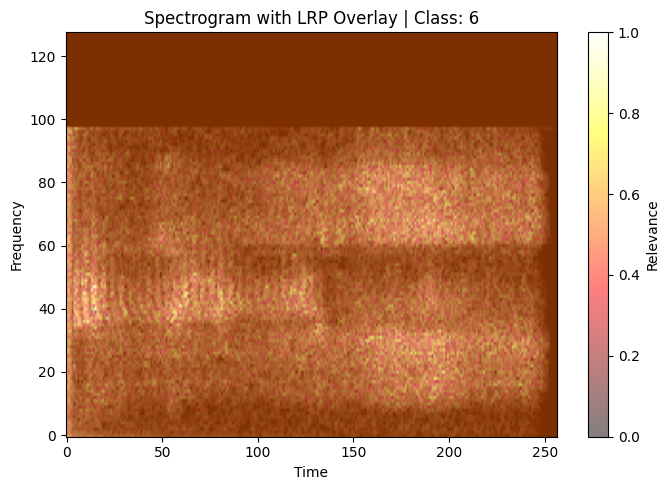

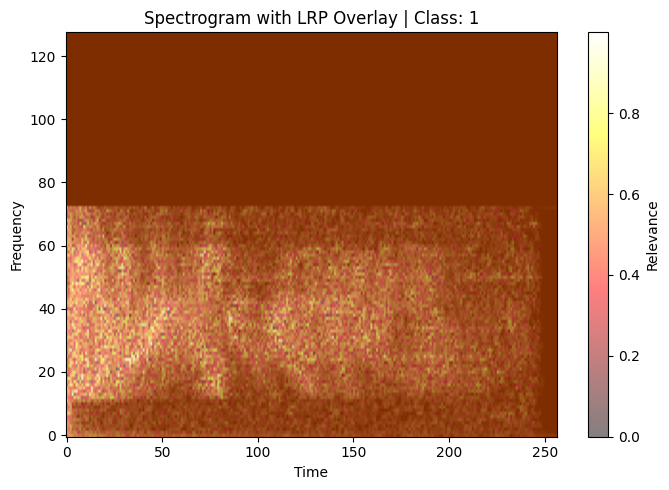

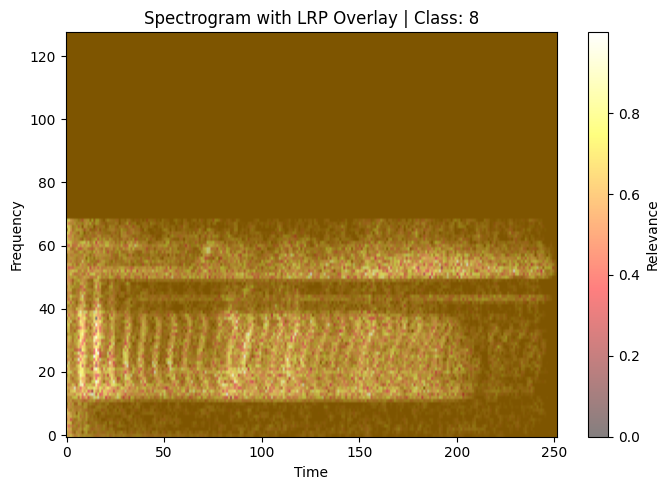

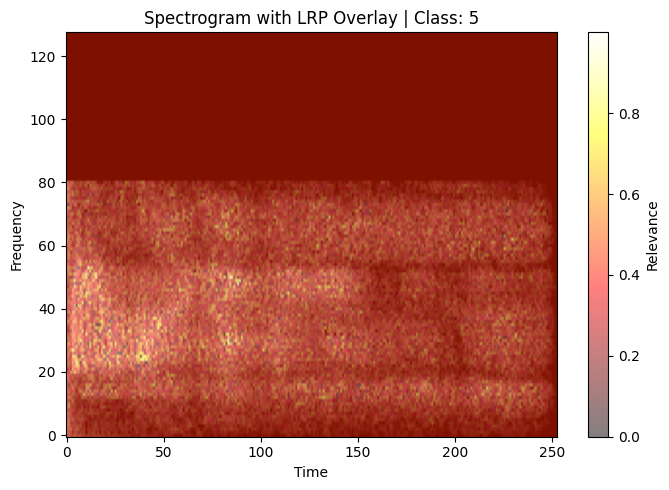

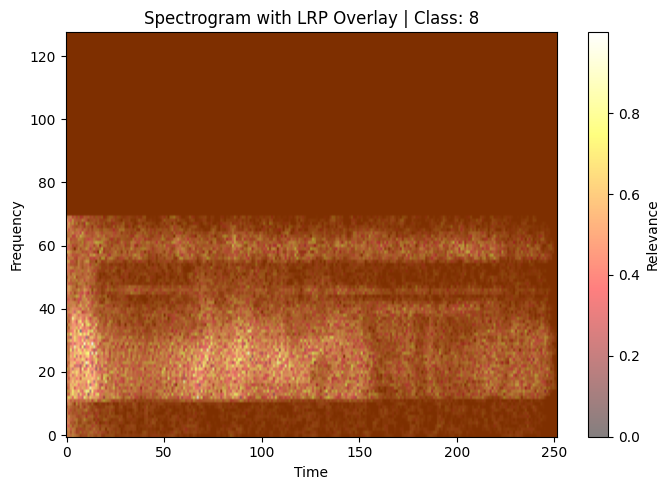

In [ ]:
import random

class_names = [str(i) for i in range(10)] 

num_samples = 5
indices = random.sample(range(X.shape[0]), num_samples)

for idx in indices:
    input_sample = X[idx:idx+1] 
    relevance = analyzer.analyze(input_sample)
    true_label = y[idx] 
    plot_spectrogram_with_lrp(input_sample, relevance, label=true_label, class_names=class_names)


In [ ]:
def plot_spectrogram_with_lrp(input_sample, relevance, label=None, class_names=None):
    import matplotlib.pyplot as plt
    import numpy as np

    spect = input_sample[0, :, :, 0]
    rel = relevance[0, :, :, 0]
    energy_row = np.sum(np.abs(spect), axis=1)
    valid_rows = np.where(energy_row > 1e-5)[0]

    energy_col = np.sum(np.abs(spect), axis=0)
    valid_cols = np.where(energy_col > 1e-5)[0]

    rmin, rmax = np.min(valid_rows), np.max(valid_rows)
    cmin, cmax = np.min(valid_cols), np.max(valid_cols)

    spect_crop = spect[rmin:rmax+1, cmin:cmax+1]
    rel_crop = rel[rmin:rmax+1, cmin:cmax+1]
    rel_norm = (rel_crop - np.min(rel_crop)) / (np.max(rel_crop) - np.min(rel_crop) + 1e-10)

    plt.figure(figsize=(8, 5))
    plt.title(f"Spectrogram with LRP Overlay - Class '{class_names[label]}'" if class_names else "Spectrogram with LRP Overlay")

    plt.imshow(spect_crop.T, origin="lower", aspect="auto", cmap="gray")
    plt.imshow(rel_norm.T, origin="lower", aspect="auto", cmap="hot", alpha=0.6)

    cbar = plt.colorbar()
    cbar.set_label("Relevance")

    plt.xlabel("Time Frames")
    plt.ylabel("Frequency Bins")
    plt.tight_layout()
    plt.show()


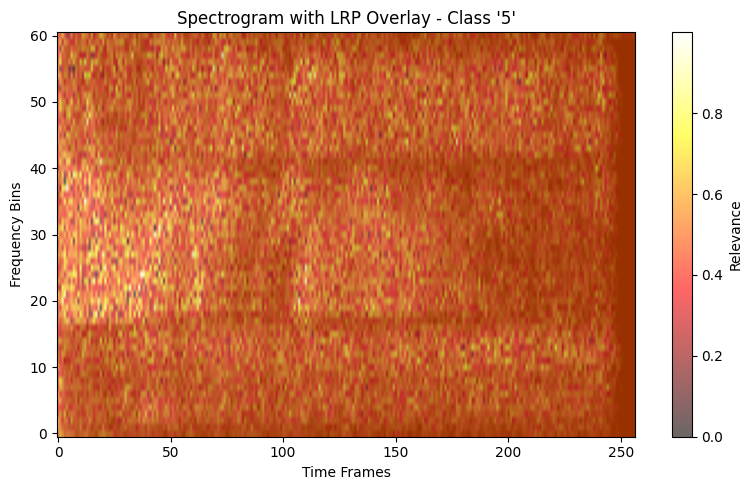

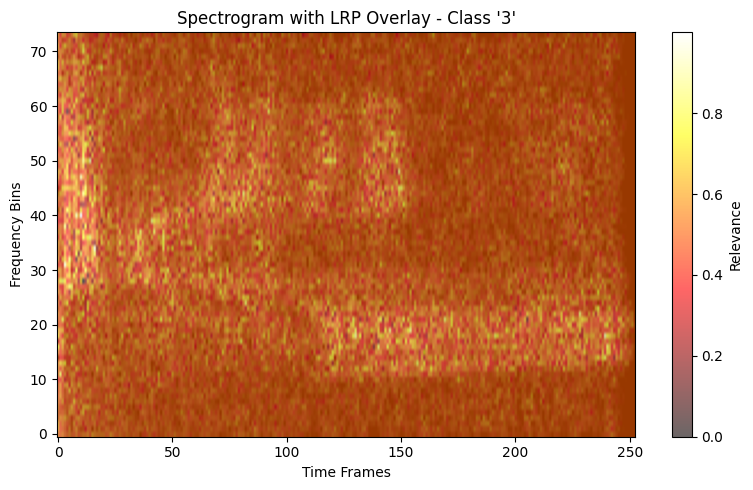

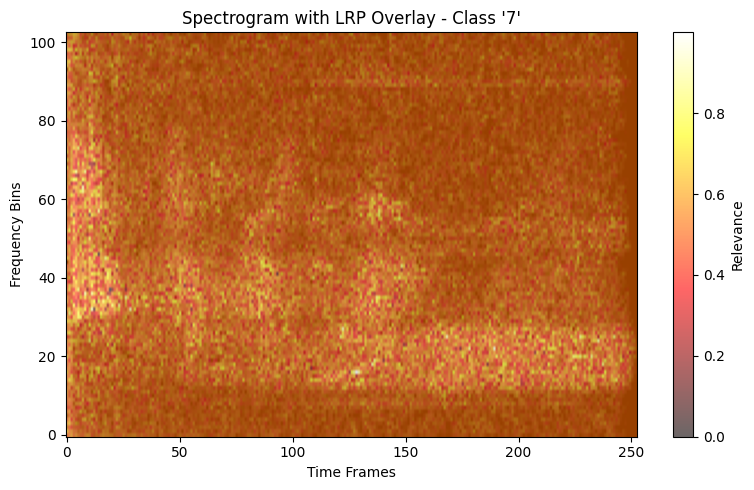

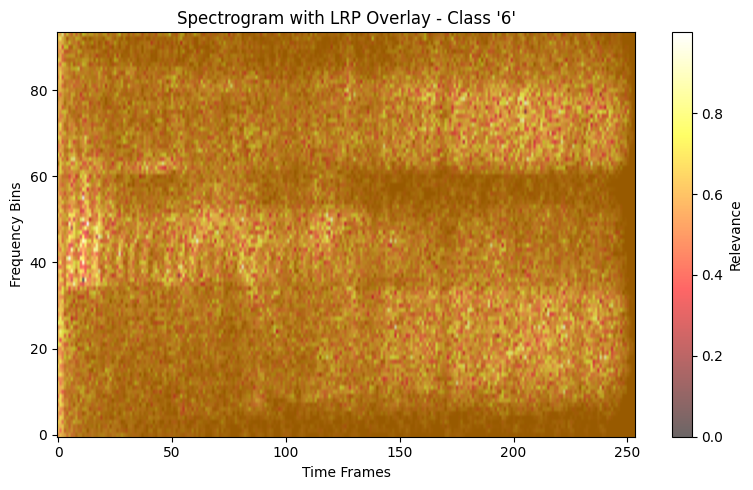

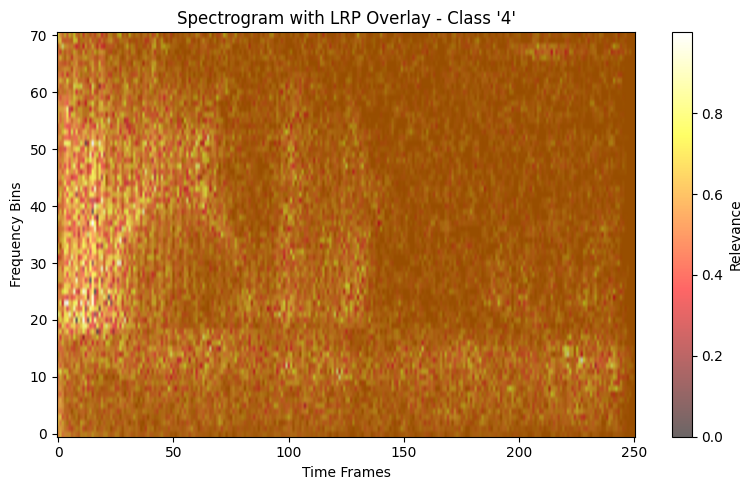

In [ ]:
import random

class_names = [str(i) for i in range(10)]

num_samples = 5
indices = random.sample(range(X.shape[0]), num_samples)

for idx in indices:
    input_sample = X[idx:idx+1]
    relevance = analyzer.analyze(input_sample)
    true_label = y[idx] 
    plot_spectrogram_with_lrp(input_sample, relevance, label=true_label, class_names=class_names)


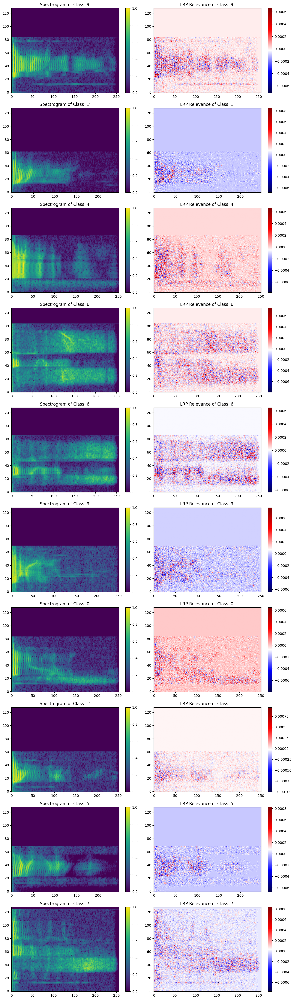

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

num_samples_to_plot = 10
indices = random.sample(range(X.shape[0]), num_samples_to_plot)

plt.figure(figsize=(12, 4 * num_samples_to_plot))

for i, idx in enumerate(indices):
    input_sample = X[idx:idx + 1]
    label = y[idx]

    relevance = analyzer.analyze(input_sample)

    non_zero_freq = np.where(np.max(input_sample[0, :, :, 0], axis=1) > 0)[0]
    min_freq = non_zero_freq[0] if len(non_zero_freq) > 0 else 0
    max_freq = non_zero_freq[-1] if len(non_zero_freq) > 0 else input_sample.shape[1]

    freq_crop = slice(min_freq, max_freq)


    plt.subplot(num_samples_to_plot, 2, 2 * i + 1)
    plt.title(f"Spectrogram of Class '{label}'")
    plt.imshow(input_sample[0, freq_crop, :, 0].T, origin="lower", aspect="auto", cmap="viridis")
    plt.colorbar()
    plt.subplot(num_samples_to_plot, 2, 2 * i + 2)
    plt.title(f"LRP Relevance of Class '{label}'")
    plt.imshow(relevance[0, freq_crop, :, 0].T, origin="lower", aspect="auto", cmap="seismic")
    plt.colorbar()

plt.tight_layout()
plt.show()


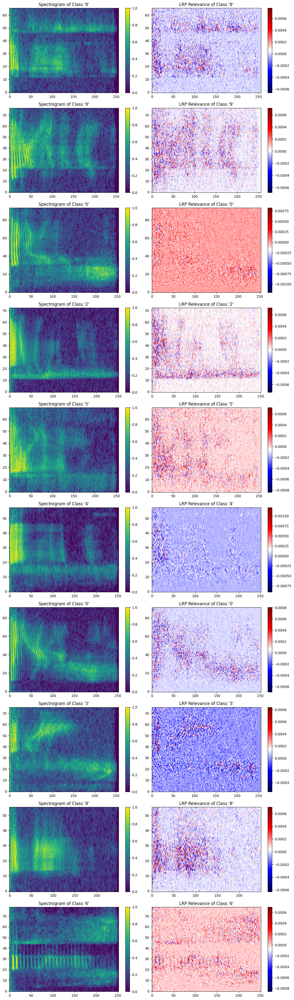

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

num_samples_to_plot = 10
indices = random.sample(range(X.shape[0]), num_samples_to_plot)

plt.figure(figsize=(12, 4 * num_samples_to_plot))

for i, idx in enumerate(indices):
    input_sample = X[idx:idx + 1]
    label = y[idx] 

    relevance = analyzer.analyze(input_sample)
    non_zero_freq = np.where(np.max(input_sample[0, :, :, 0], axis=1) > 0)[0]
    min_freq = non_zero_freq[0] if len(non_zero_freq) > 0 else 0
    max_freq = non_zero_freq[-1] if len(non_zero_freq) > 0 else input_sample.shape[1]
    non_zero_time = np.where(np.max(input_sample[0, :, :, 0], axis=0) > 0)[0]
    min_time = non_zero_time[0] if len(non_zero_time) > 0 else 0
    max_time = non_zero_time[-1] if len(non_zero_time) > 0 else input_sample.shape[2]
    freq_crop = slice(min_freq, max_freq)
    time_crop = slice(min_time, max_time)
    plt.subplot(num_samples_to_plot, 2, 2 * i + 1)
    plt.title(f"Spectrogram of Class '{label}'")
    plt.imshow(input_sample[0, freq_crop, time_crop, 0].T, origin="lower", aspect="auto", cmap="viridis")
    plt.colorbar()
    plt.subplot(num_samples_to_plot, 2, 2 * i + 2)
    plt.title(f"LRP Relevance of Class '{label}'")
    plt.imshow(relevance[0, freq_crop, time_crop, 0].T, origin="lower", aspect="auto", cmap="seismic")
    plt.colorbar()

plt.tight_layout()
plt.show()
